In [1]:
import torch
import torchvision
import numpy as np
import matplotlib.pyplot as plt
import torch.nn as nn
import matplotlib.pyplot as plt
import torchvision.utils as vutils
# !pip install torchinfo
from torchinfo import summary
from tqdm.auto import tqdm
from pathlib import Path
# !pip install torch-fidelity
import torch_fidelity
# !pip install pytorch-fid
from pytorch_fid import fid_score
import torch.nn.functional as F
import os
import json

In [2]:
transformer_CIFAR = torchvision.transforms.Compose([
    torchvision.transforms.Resize((64,64)),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize(mean=(0.5,0.5,0.5),std=(0.5,0.5,0.5))

])

In [4]:
batch_size = 128
train_dataset = torchvision.datasets.CIFAR10(root="../datasets", train=True, download=True, transform=transformer_CIFAR)
test_dataset = torchvision.datasets.CIFAR10(root="../datasets", train=False, download=True, transform=transformer_CIFAR)
train_data = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_data = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=True)

In [ ]:
z_dim = 64
out_channels = 3
lr = 2e-4
epochs = 10
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

In [6]:
class VAE(nn.Module):
    def __init__(self,in_channels=3, latent_dim=64, feature_map_enc=64, feature_map_dec=64):
        super(VAE, self).__init__()
        # Encoder
        self.enc_conv1 = nn.Conv2d(in_channels, feature_map_enc, kernel_size=4, stride=2, padding=1)  # 64->32
        self.enc_bn1 = nn.BatchNorm2d(feature_map_enc)
        self.enc_conv2 = nn.Conv2d(feature_map_enc, feature_map_enc*2, kernel_size=4, stride=2, padding=1) # 32->16
        self.enc_bn2 = nn.BatchNorm2d(feature_map_enc*2)
        self.enc_conv3 = nn.Conv2d(feature_map_enc*2, feature_map_enc*4, kernel_size=4, stride=2, padding=1) # 16->8
        self.enc_bn3 = nn.BatchNorm2d(feature_map_enc*4)
        self.enc_conv4 = nn.Conv2d(feature_map_enc*4, feature_map_enc*8, kernel_size=4, stride=2, padding=1) # 8->4
        self.enc_bn4 = nn.BatchNorm2d(feature_map_enc*8)

        self.enc_fc = nn.Linear(feature_map_enc*8*4*4, 512)
        self.fc_mu = nn.Linear(512, latent_dim)
        self.fc_logvar = nn.Linear(512, latent_dim)

        # Decoder
        self.dec_fc = nn.Linear(latent_dim, 512)
        self.dec_fc2 = nn.Linear(512, feature_map_enc*8*4*4)

        #Decoder Conv Layers
        self.dec_deconv1 = nn.ConvTranspose2d(feature_map_dec*8, feature_map_dec*4, kernel_size=4, stride=2, padding=1) # 4->8
        self.dec_bn1 = nn.BatchNorm2d(feature_map_dec*4)
        self.dec_deconv2 = nn.ConvTranspose2d(feature_map_dec*4, feature_map_dec*2, kernel_size=4, stride=2, padding=1)  # 8->16
        self.dec_bn2 = nn.BatchNorm2d(feature_map_dec*2)
        self.dec_deconv3 = nn.ConvTranspose2d(feature_map_dec*2, feature_map_dec, kernel_size=4, stride=2, padding=1) # 16->32
        self.dec_bn3 = nn.BatchNorm2d(feature_map_dec)
        self.dec_deconv4 = nn.ConvTranspose2d(feature_map_dec, in_channels, kernel_size=4, stride=2, padding=1) # 32->64

        self._initialize_weights()


    def _initialize_weights(self):
        for layer in self.modules():
            if isinstance(layer, (nn.Conv2d, nn.ConvTranspose2d)):
                nn.init.normal_(layer.weight.data, mean=0.0, std=0.02)
            elif isinstance(layer, nn.BatchNorm2d):
                nn.init.normal_(layer.weight.data, mean=1.0, std=0.02)
                nn.init.constant_(layer.bias.data, 0.0)
            elif isinstance(layer, nn.Linear):
                nn.init.normal_(layer.weight.data, mean=0.0, std=0.02)
                if layer.bias is not None:
                    nn.init.constant_(layer.bias.data, 0.0)

    def encode(self, x):
        x = F.leaky_relu(self.enc_bn1(self.enc_conv1(x)), 0.2)
        x = F.leaky_relu(self.enc_bn2(self.enc_conv2(x)), 0.2)
        x = F.leaky_relu(self.enc_bn3(self.enc_conv3(x)), 0.2)
        x = F.leaky_relu(self.enc_bn4(self.enc_conv4(x)), 0.2)

        x = x.view(x.size(0), -1)
        hidden = F.relu(self.enc_fc(x))
        mu = self.fc_mu(hidden)
        logvar = self.fc_logvar(hidden)
        return mu, logvar

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5*logvar)
        eps = torch.randn_like(std)
        return mu + eps*std

    def decode(self, z):
        hidden = F.relu(self.dec_fc(z))
        hidden = F.relu(self.dec_fc2(hidden))
        hidden = hidden.view(-1, 512, 4, 4)
        hidden = F.relu(self.dec_deconv1(hidden))
        hidden = F.relu(self.dec_deconv2(hidden))
        hidden = F.relu(self.dec_deconv3(hidden))

        x_reconstructed = torch.tanh(self.dec_deconv4(hidden))
        return x_reconstructed

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterize(mu, logvar)
        return self.decode(z), mu, logvar



In [7]:
classes_list = train_dataset.classes
classes_list

['airplane',
 'automobile',
 'bird',
 'cat',
 'deer',
 'dog',
 'frog',
 'horse',
 'ship',
 'truck']

In [8]:
img,_ = train_dataset[0]
color_channels, height, width = img.shape
color_channels,height,width

(3, 64, 64)

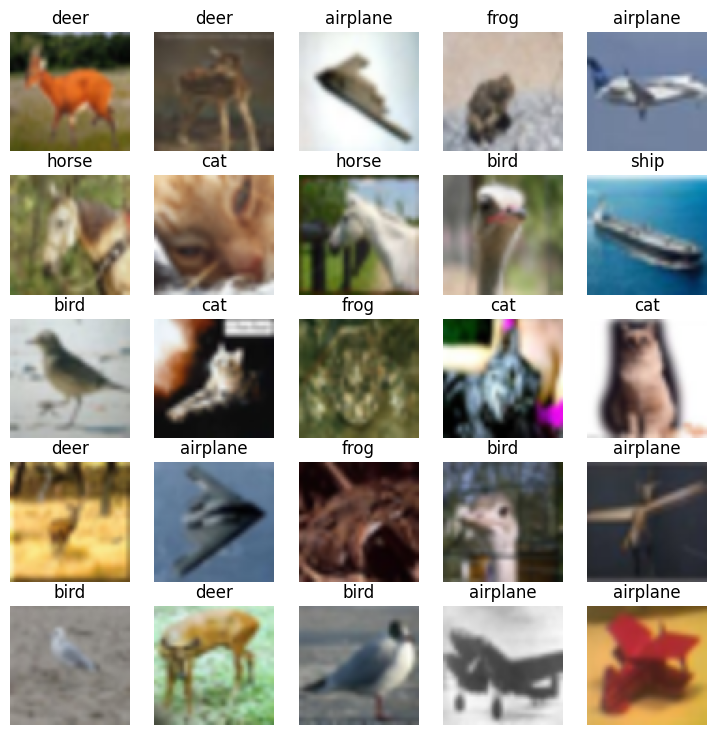

In [ ]:
# fig = plt.figure(figsize=(9, 9))
# rows, cols = 5, 5
# for i in range(1, rows * cols + 1):
#     random_idx = torch.randint(0, len(train_dataset), size=(1,)).item()
#     image, label = train_dataset[random_idx]
#     image_np = image*0.5+0.5
#     image_np = image_np.permute(1, 2, 0).numpy()
#     fig.add_subplot(rows, cols, i)
#     plt.imshow(image_np.squeeze())
#     plt.title(classes_list[label])
#     plt.axis(False)

In [ ]:
# vae = VAE().to(device=DEVICE)
beta =1.0
feature_map = 64
# summary(vae, (batch_size, color_channels, height, width))


Layer (type:depth-idx)                   Output Shape              Param #
VAE                                      [128, 3, 64, 64]          896
├─Conv2d: 1-1                            [128, 64, 32, 32]         3,136
├─BatchNorm2d: 1-2                       [128, 64, 32, 32]         128
├─Conv2d: 1-3                            [128, 128, 16, 16]        131,200
├─BatchNorm2d: 1-4                       [128, 128, 16, 16]        256
├─Conv2d: 1-5                            [128, 256, 8, 8]          524,544
├─BatchNorm2d: 1-6                       [128, 256, 8, 8]          512
├─Conv2d: 1-7                            [128, 512, 4, 4]          2,097,664
├─BatchNorm2d: 1-8                       [128, 512, 4, 4]          1,024
├─Linear: 1-9                            [128, 512]                4,194,816
├─Linear: 1-10                           [128, 64]                 32,832
├─Linear: 1-11                           [128, 64]                 32,832
├─Linear: 1-12                           [1

In [63]:
def vae_loss_function(recon_x, x, mu, logvar, beta=1.0):
  mse = nn.MSELoss(reduction="sum")
  recon = mse(recon_x, x)

  kld = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())

  loss = recon + kld

  return loss, recon, kld

In [ ]:
# optimizer_vae = torch.optim.Adam(params=vae.parameters(), lr=lr, betas=(0.9,0.999))
# results = {
#     "Train Loss": [],
#     "Train Reconstruction": [],
#     "Train KLD": [],
#     "Test Loss": [],
#     "Test Reconstruction": [],
#     "Test KLD": [],
#     "steps": [],
#     "FID_score": [],
#     "hyperparameters": {
#         "lr": lr,
#         "beta": beta,
#         "batch_size": batch_size,
#         "z_dim": z_dim,
#         "feature_map": feature_map,
#         "epochs": epochs,
#         "optimizer_betas": [0.9, 0.999]
#     }
# }

# os.makedirs("vae_checkpoints", exist_ok=True)
# os.makedirs("fid_real", exist_ok=True)  # create folder if it doesn't exist
# os.makedirs("fid_fake", exist_ok=True)
# os.makedirs("outputs", exist_ok=True)
# os.makedirs("checkpoints", exist_ok=True)
# os.makedirs("samples", exist_ok=True)


# save_model_every = 2  # Save model every 5 epochs
# save_outputs_every = 1
# to_pil = torchvision.transforms.ToPILImage()

# fixed_batch, _ = next(iter(test_data))
# fixed_batch = fixed_batch[:16].to(DEVICE)
# step=0


In [ ]:
# real_dir_str = "./fid_real"
# fake_dir_str = "./fid_fake"
# real_dir = Path(real_dir_str)
# fake_dir = Path(fake_dir_str)
# Path("vae_samples").mkdir(parents=True, exist_ok=True)
# Path("vae_checkpoints").mkdir(parents=True, exist_ok=True)
# Path("fid_real").mkdir(parents=True, exist_ok=True)
# Path("fid_fake").mkdir(parents=True, exist_ok=True)
# fixed_noise = torch.randn(64, z_dim).to(DEVICE)
# # fid_value = fid_score.calculate_fid_given_paths([real_dir_str, fake_dir_str], batch_size=128, device=DEVICE, dims=2048)

Epoch [1/10] Step [0] Loss: 7.5883 | Recon: 7.5685 | KLD: 0.0198


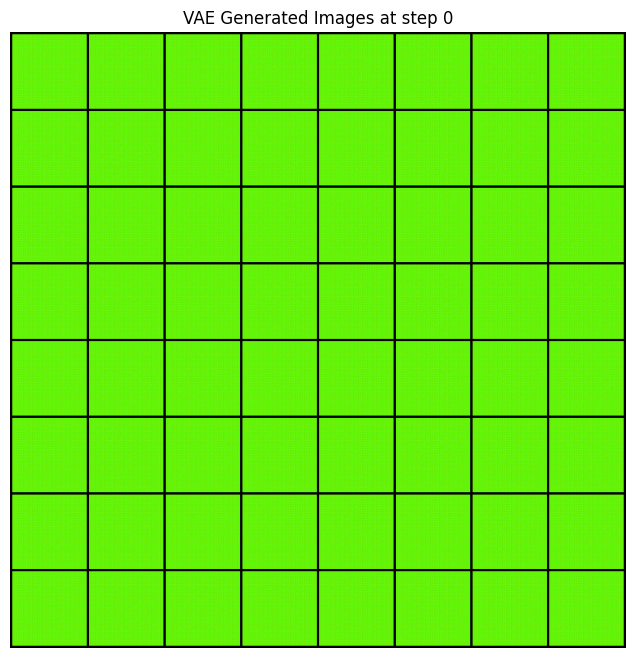

VAE checkpoint saved at step 0
Epoch [1/10] Step [100] Loss: 4.8251 | Recon: 4.7390 | KLD: 0.0862


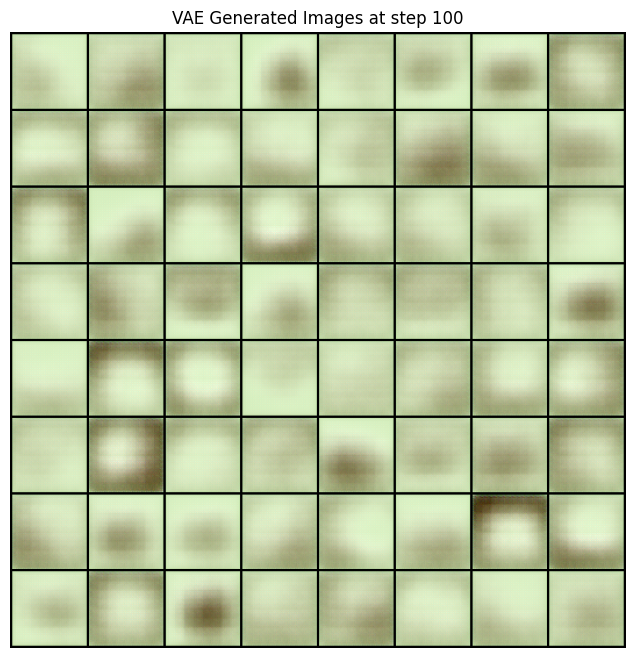

Epoch [1/10] Step [200] Loss: 2.9092 | Recon: 2.7265 | KLD: 0.1827


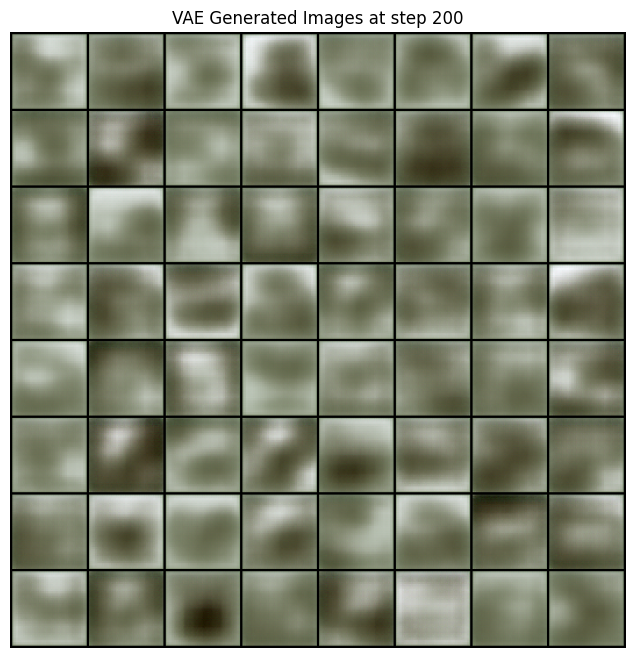

Epoch [1/10] Step [300] Loss: 2.4767 | Recon: 2.2914 | KLD: 0.1853


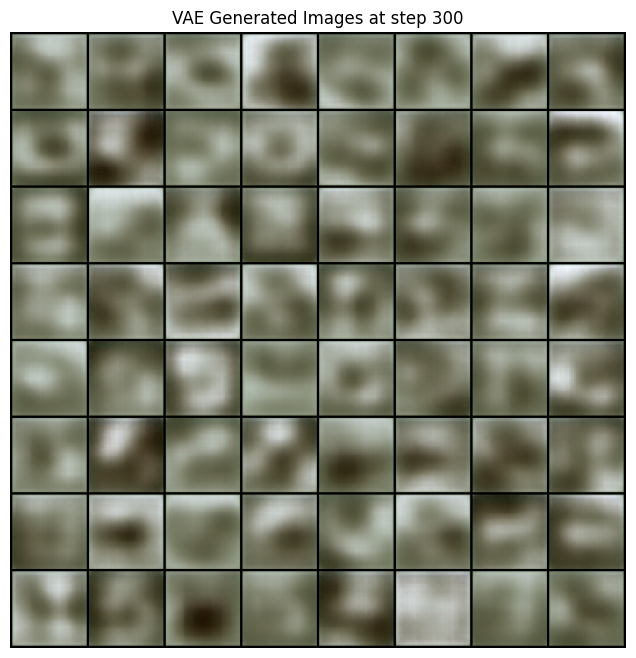

100%|██████████| 4/4 [00:02<00:00,  1.90it/s]



Epoch [1/10] Summary:
Train - Loss: 1500.7368, Recon: 1442.1352, KLD: 58.6016
Test  - Loss: 198.8201, Recon: 183.3649, KLD: 15.4553
FID   - 362.9599
Epoch [2/10] Step [400] Loss: 2.4113 | Recon: 2.2127 | KLD: 0.1986


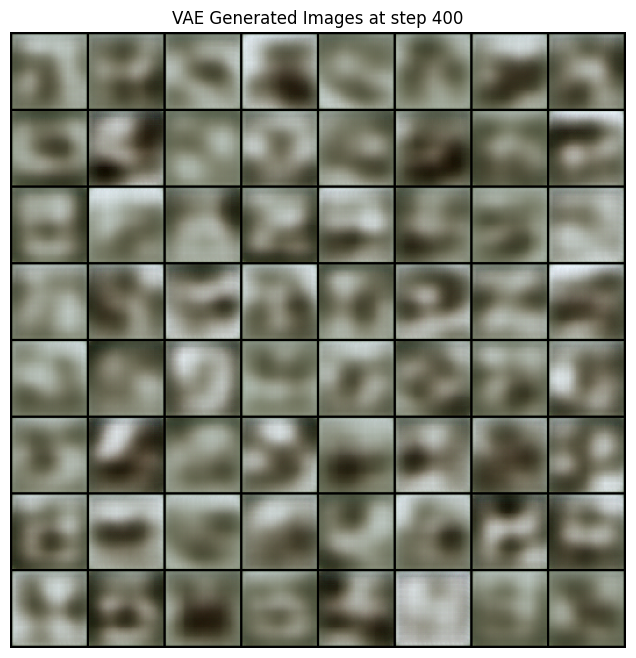

Epoch [2/10] Step [500] Loss: 2.4304 | Recon: 2.2308 | KLD: 0.1996


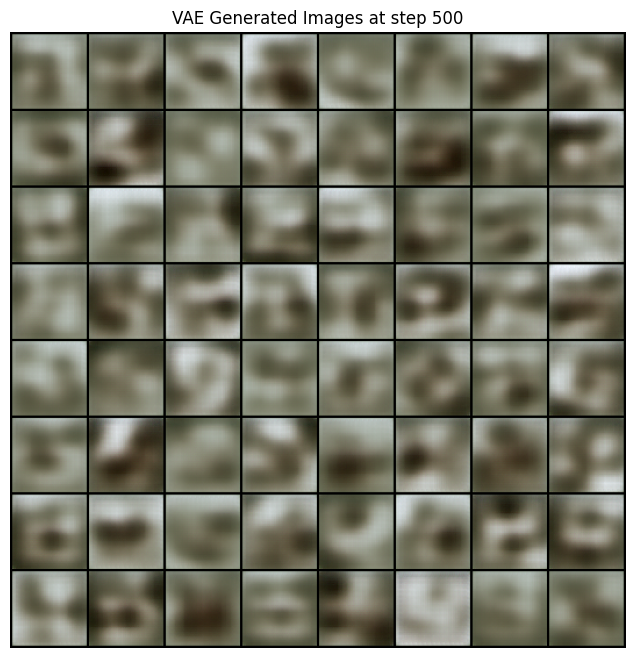

Epoch [2/10] Step [600] Loss: 2.2241 | Recon: 2.0172 | KLD: 0.2069


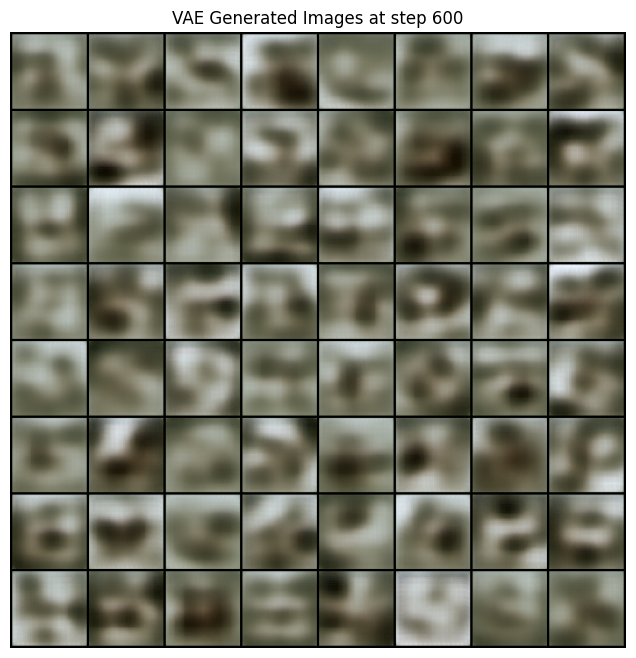

Epoch [2/10] Step [700] Loss: 2.0984 | Recon: 1.8889 | KLD: 0.2096


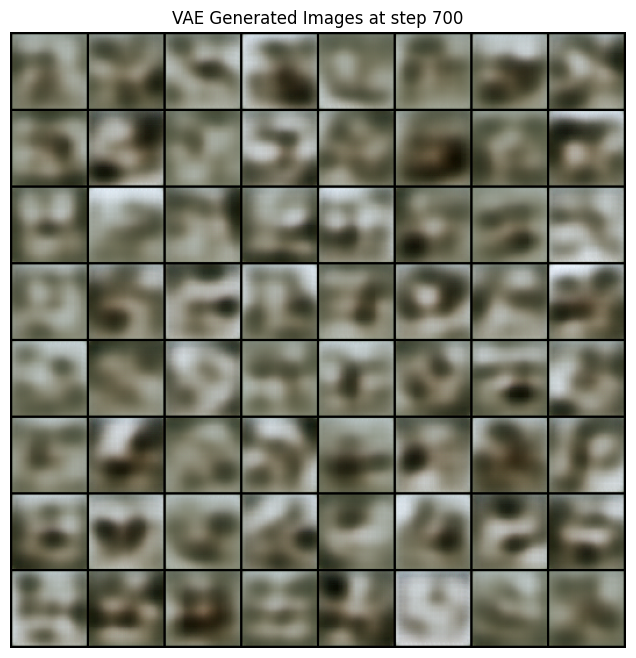

100%|██████████| 4/4 [00:02<00:00,  1.91it/s]



Epoch [2/10] Summary:
Train - Loss: 900.6734, Recon: 820.6593, KLD: 80.0141
Test  - Loss: 163.6712, Recon: 146.9599, KLD: 16.7113
FID   - 365.9283
Epoch [3/10] Step [800] Loss: 2.1217 | Recon: 1.9077 | KLD: 0.2140


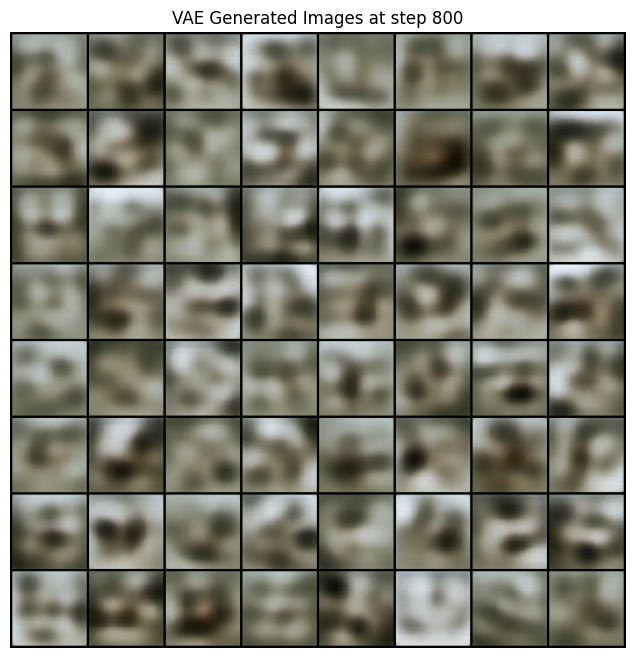

Epoch [3/10] Step [900] Loss: 2.0085 | Recon: 1.7904 | KLD: 0.2181


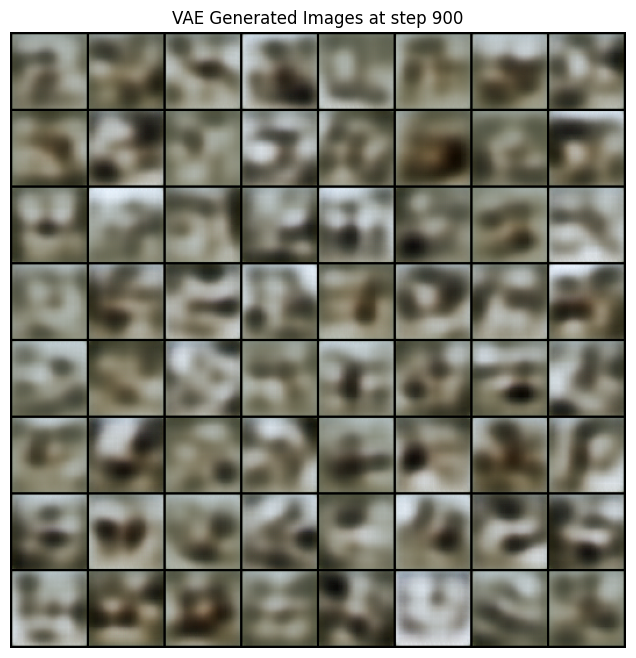

Epoch [3/10] Step [1000] Loss: 1.7848 | Recon: 1.5584 | KLD: 0.2264


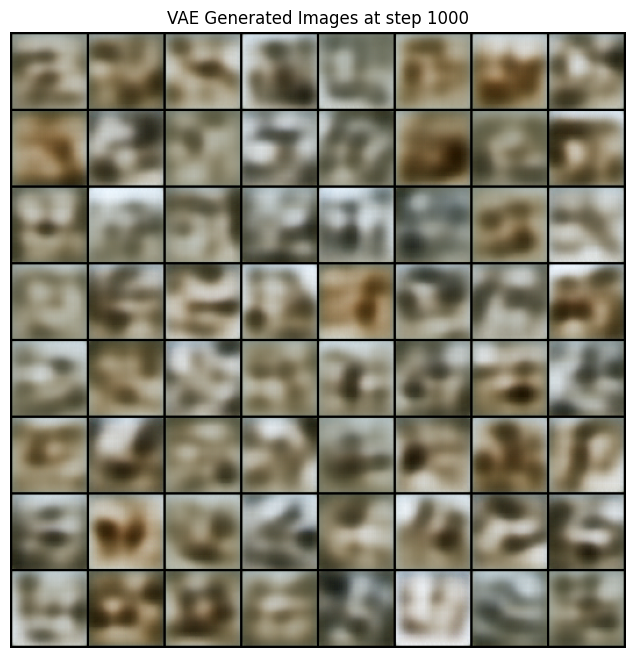

VAE checkpoint saved at step 1000
Epoch [3/10] Step [1100] Loss: 1.7841 | Recon: 1.5476 | KLD: 0.2364


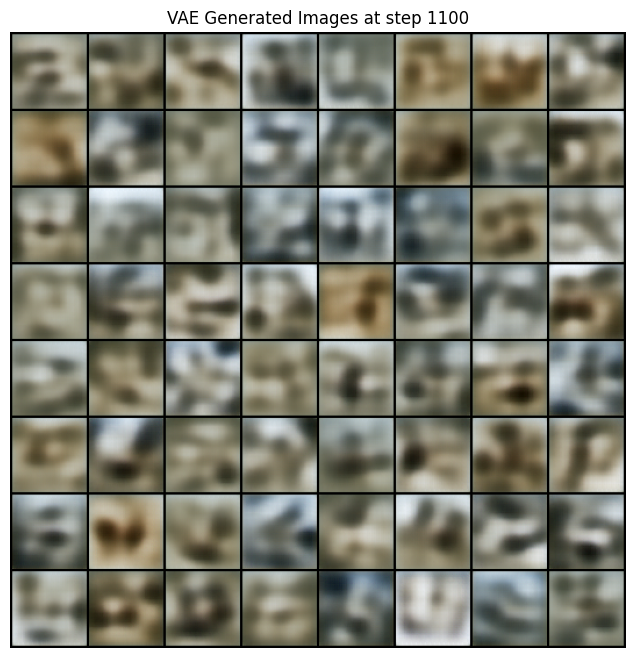

100%|██████████| 4/4 [00:02<00:00,  1.80it/s]



Epoch [3/10] Summary:
Train - Loss: 751.8201, Recon: 664.1709, KLD: 87.6492
Test  - Loss: 131.5116, Recon: 113.1484, KLD: 18.3632
FID   - 355.5166
Epoch [4/10] Step [1200] Loss: 1.8264 | Recon: 1.5979 | KLD: 0.2286


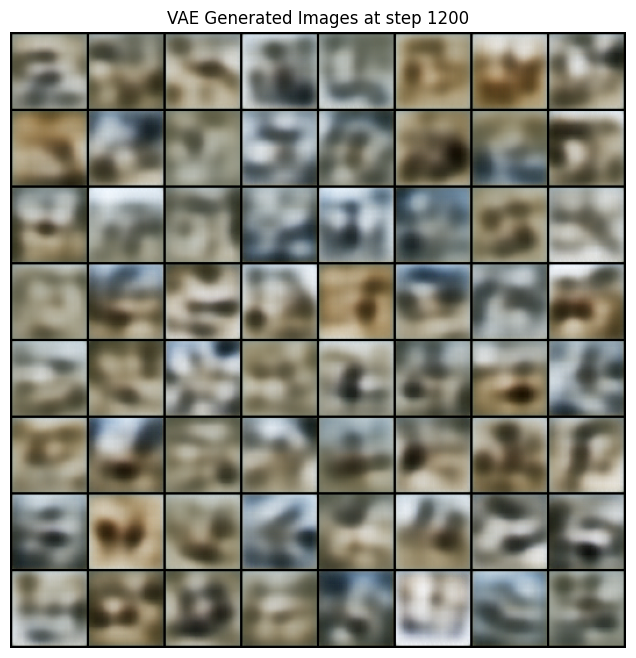

Epoch [4/10] Step [1300] Loss: 1.5859 | Recon: 1.3512 | KLD: 0.2347


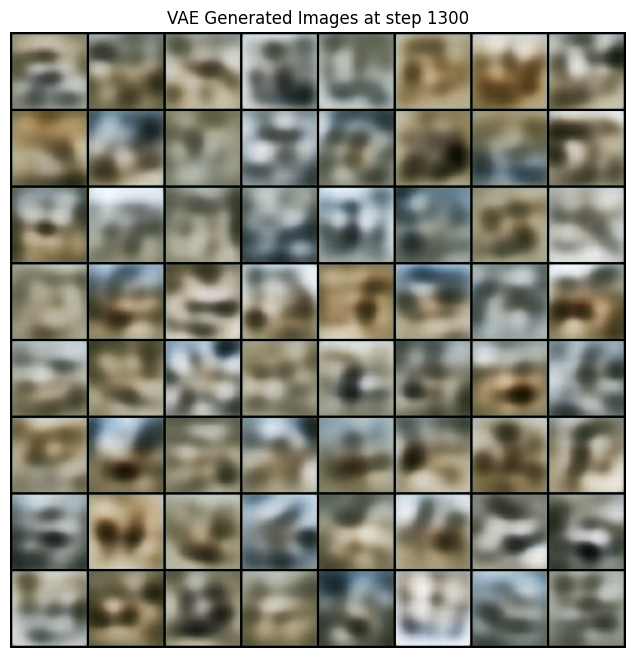

Epoch [4/10] Step [1400] Loss: 1.6104 | Recon: 1.3782 | KLD: 0.2321


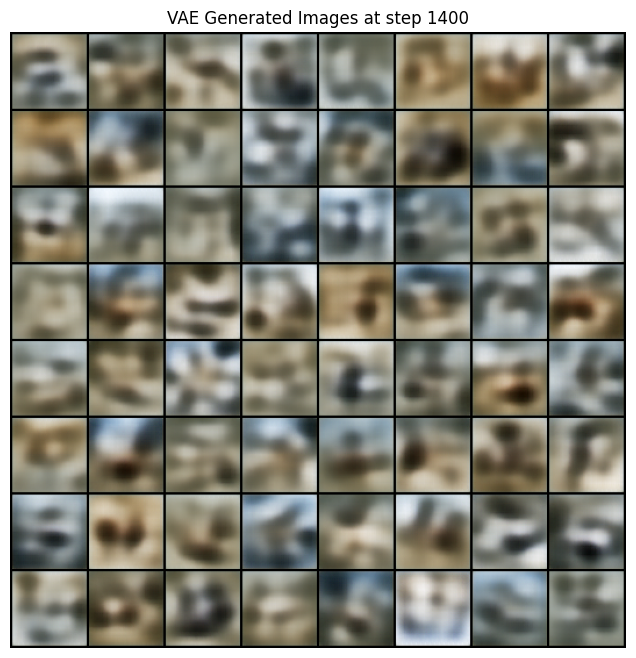

Epoch [4/10] Step [1500] Loss: 1.9910 | Recon: 1.7510 | KLD: 0.2400


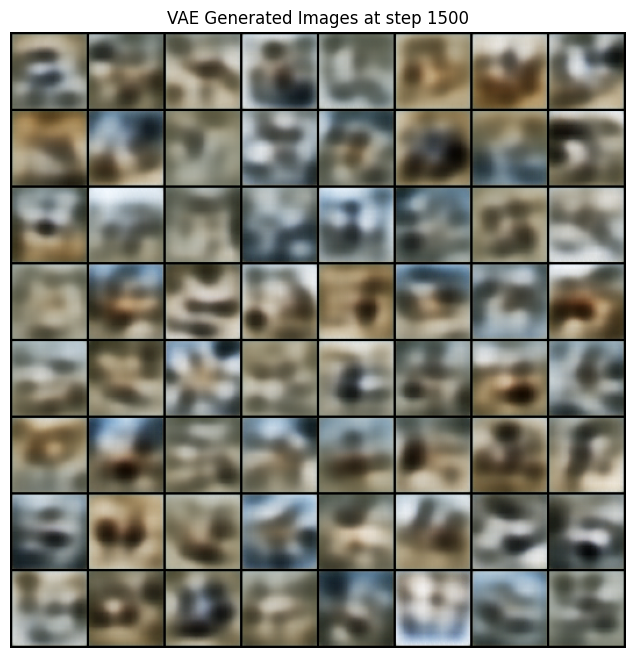

100%|██████████| 4/4 [00:02<00:00,  1.90it/s]



Epoch [4/10] Summary:
Train - Loss: 642.4213, Recon: 550.8984, KLD: 91.5229
Test  - Loss: 122.2945, Recon: 103.6674, KLD: 18.6271
FID   - 342.7502
Epoch [5/10] Step [1600] Loss: 1.5819 | Recon: 1.3487 | KLD: 0.2333


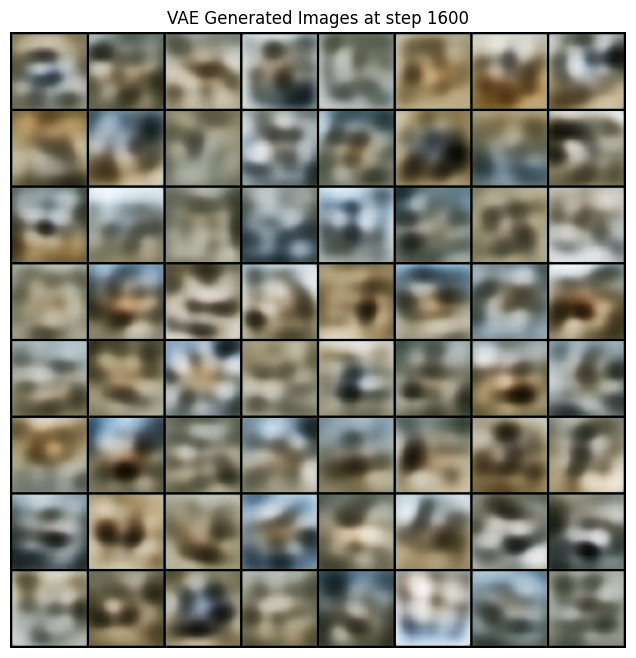

Epoch [5/10] Step [1700] Loss: 1.4844 | Recon: 1.2459 | KLD: 0.2385


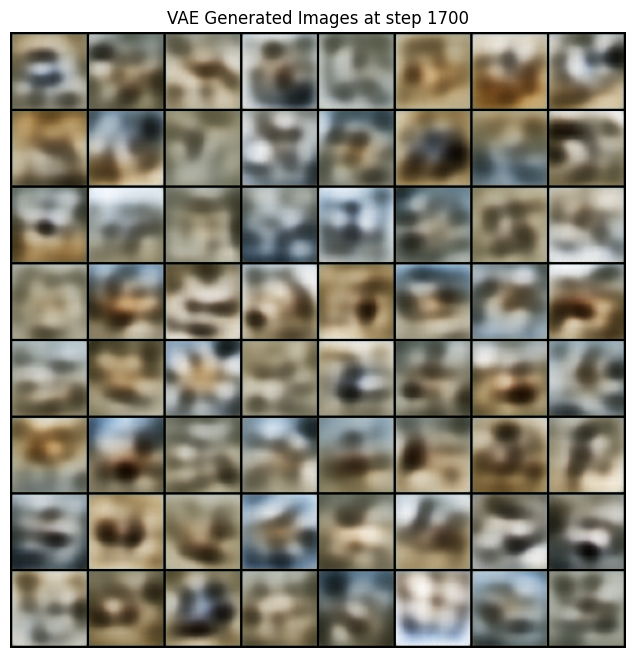

Epoch [5/10] Step [1800] Loss: 1.4798 | Recon: 1.2389 | KLD: 0.2409


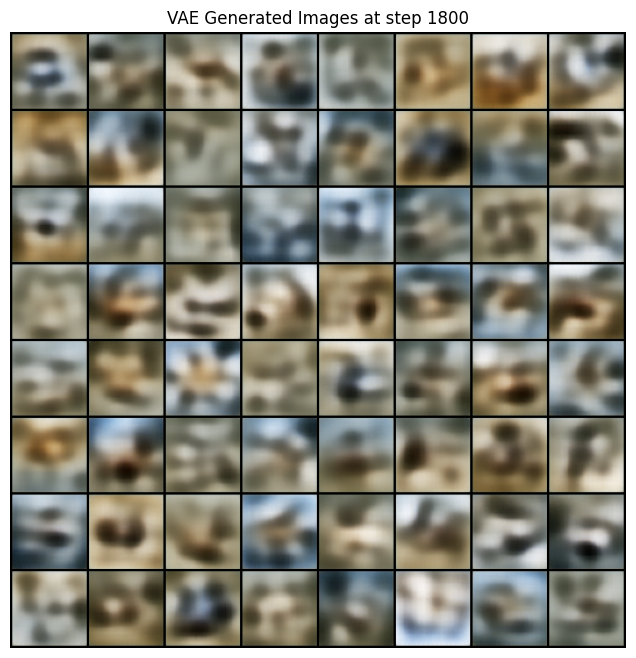

Epoch [5/10] Step [1900] Loss: 1.4689 | Recon: 1.2321 | KLD: 0.2368


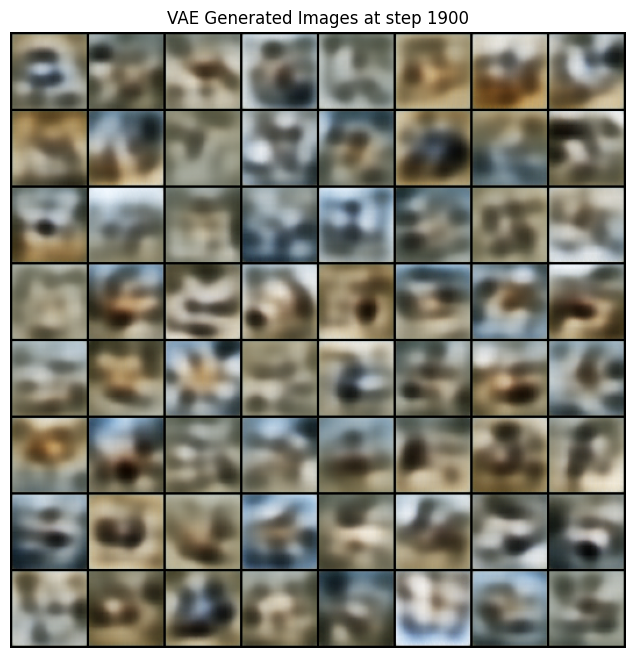

100%|██████████| 4/4 [00:02<00:00,  1.84it/s]



Epoch [5/10] Summary:
Train - Loss: 597.3449, Recon: 504.6856, KLD: 92.6592
Test  - Loss: 112.6589, Recon: 94.0555, KLD: 18.6034
FID   - 325.4315
Epoch [6/10] Step [2000] Loss: 1.4855 | Recon: 1.2434 | KLD: 0.2421


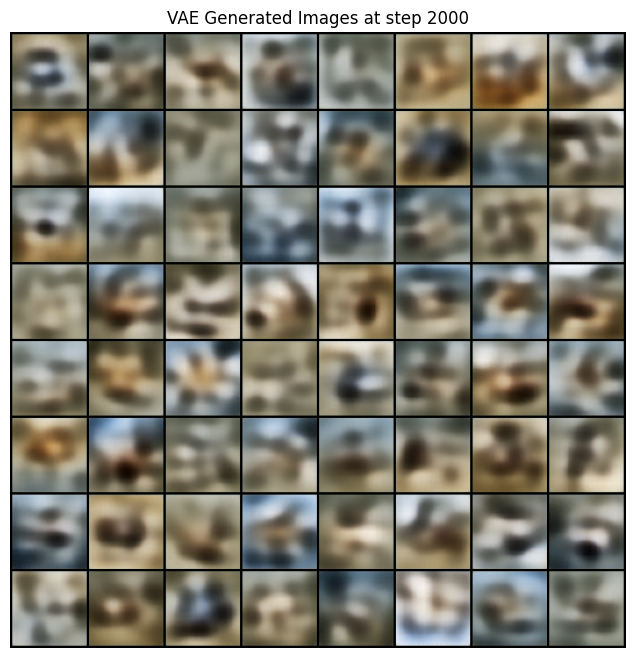

VAE checkpoint saved at step 2000
Epoch [6/10] Step [2100] Loss: 1.5248 | Recon: 1.2846 | KLD: 0.2402


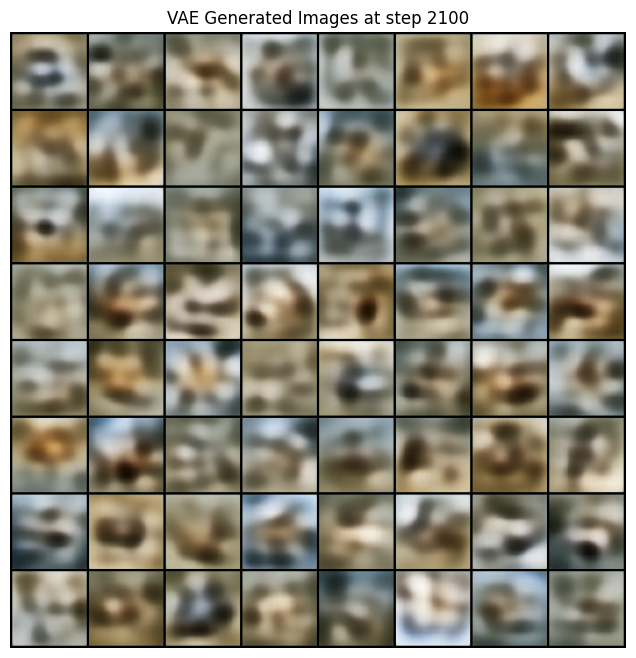

Epoch [6/10] Step [2200] Loss: 1.4089 | Recon: 1.1694 | KLD: 0.2395


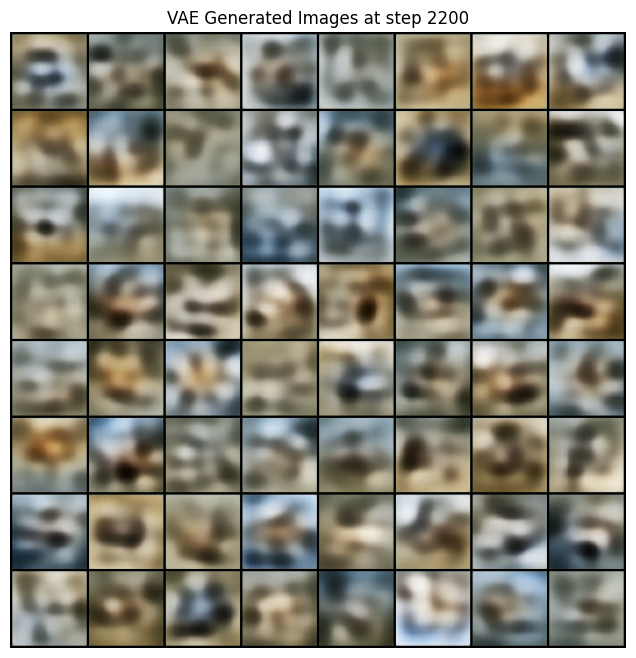

Epoch [6/10] Step [2300] Loss: 1.6270 | Recon: 1.3800 | KLD: 0.2470


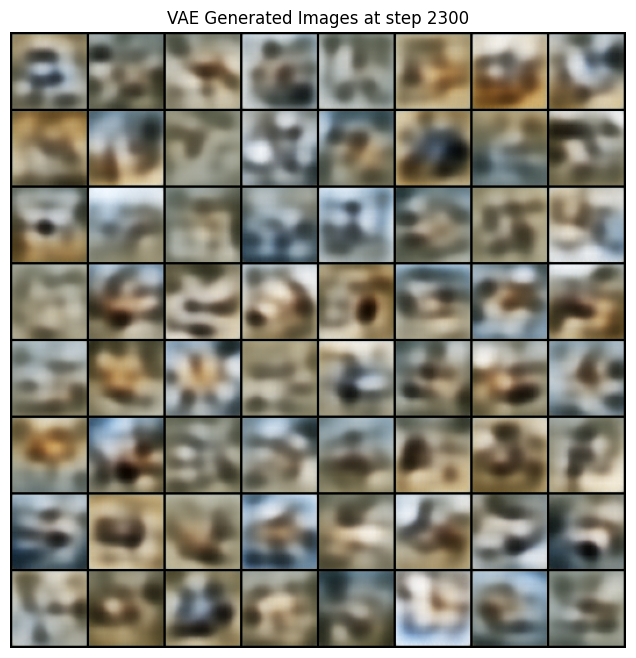

100%|██████████| 4/4 [00:02<00:00,  1.90it/s]



Epoch [6/10] Summary:
Train - Loss: 567.3514, Recon: 473.1524, KLD: 94.1989
Test  - Loss: 109.2160, Recon: 89.9129, KLD: 19.3031
FID   - 312.9741
Epoch [7/10] Step [2400] Loss: 1.3179 | Recon: 1.0765 | KLD: 0.2414


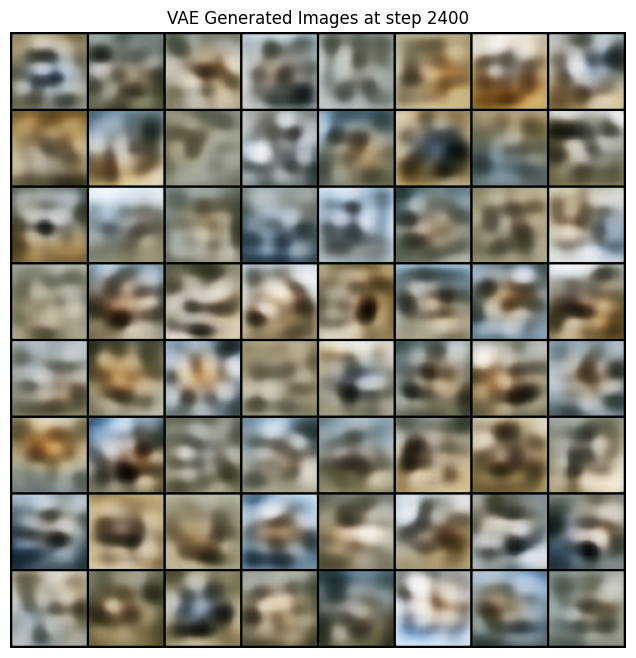

Epoch [7/10] Step [2500] Loss: 1.3839 | Recon: 1.1426 | KLD: 0.2413


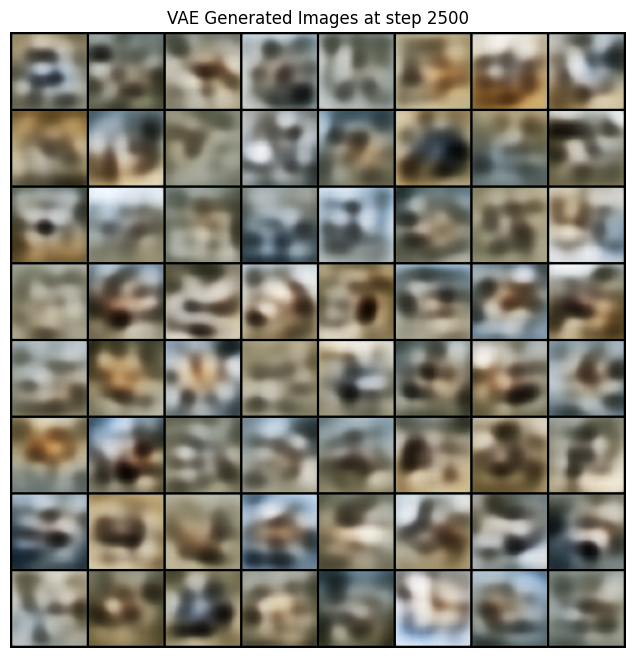

Epoch [7/10] Step [2600] Loss: 1.3527 | Recon: 1.1119 | KLD: 0.2408


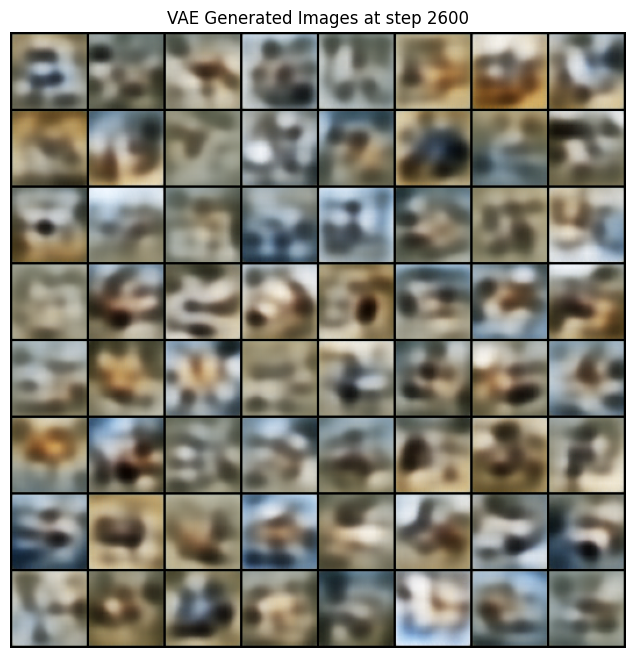

Epoch [7/10] Step [2700] Loss: 1.2898 | Recon: 1.0497 | KLD: 0.2401


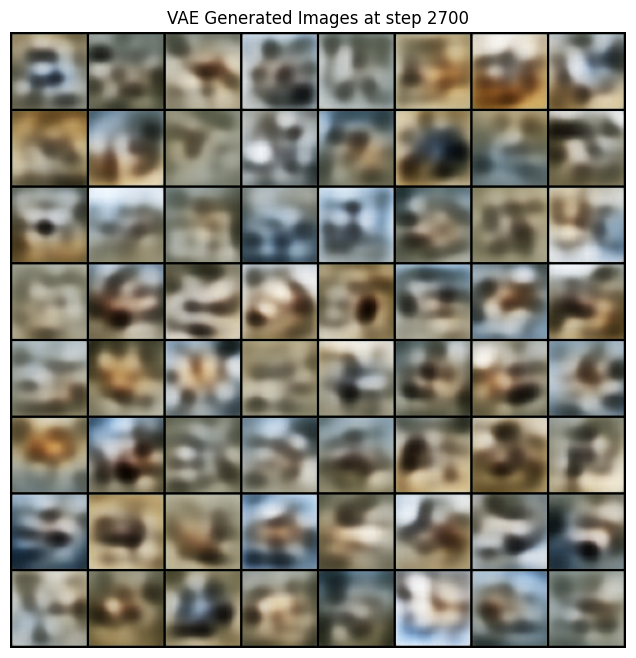

100%|██████████| 4/4 [00:02<00:00,  1.87it/s]



Epoch [7/10] Summary:
Train - Loss: 539.9602, Recon: 445.2796, KLD: 94.6806
Test  - Loss: 104.4159, Recon: 85.4166, KLD: 18.9993
FID   - 309.9056
Epoch [8/10] Step [2800] Loss: 1.4090 | Recon: 1.1645 | KLD: 0.2446


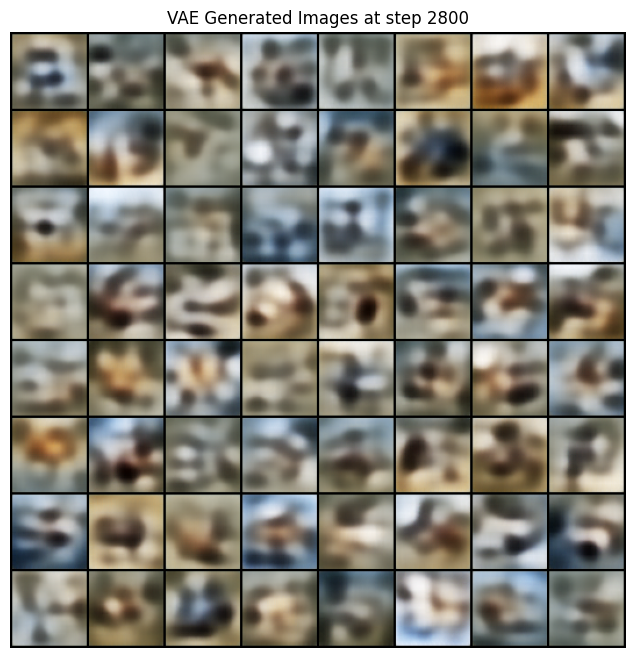

Epoch [8/10] Step [2900] Loss: 1.3072 | Recon: 1.0666 | KLD: 0.2406


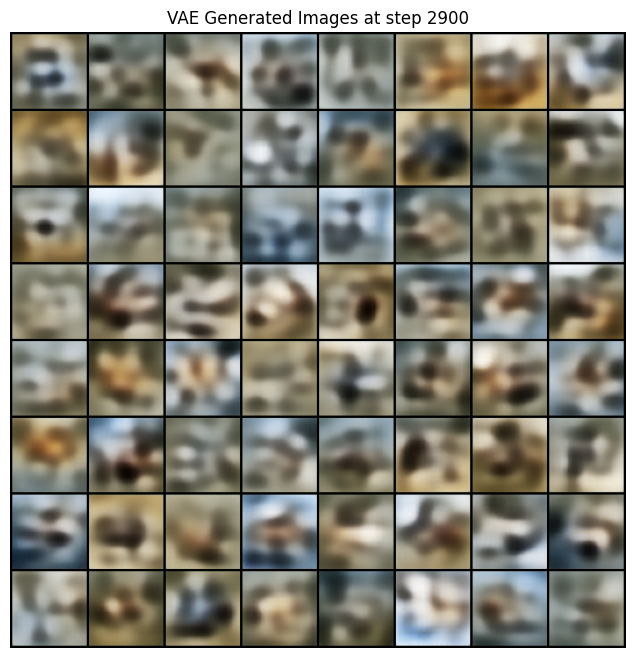

Epoch [8/10] Step [3000] Loss: 1.3981 | Recon: 1.1560 | KLD: 0.2421


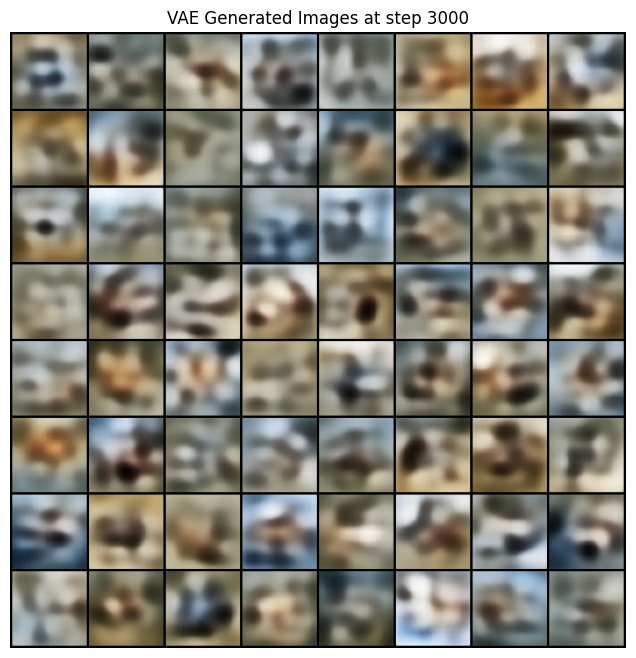

VAE checkpoint saved at step 3000
Epoch [8/10] Step [3100] Loss: 1.3394 | Recon: 1.0986 | KLD: 0.2408


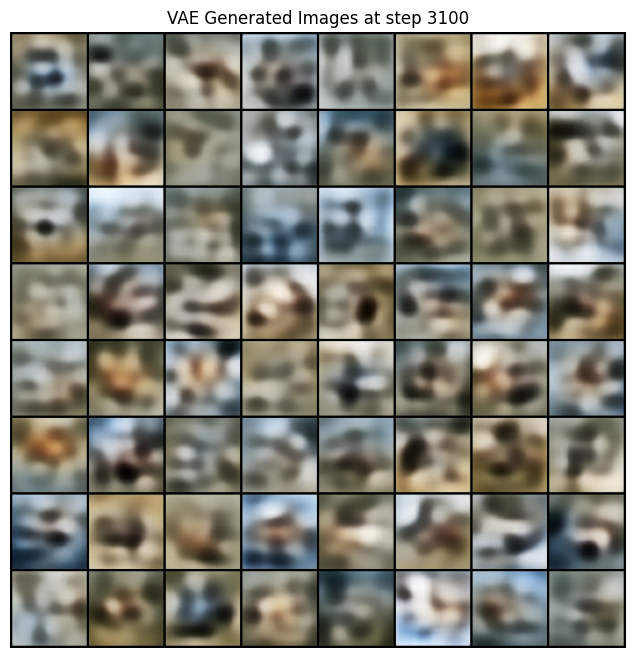

100%|██████████| 4/4 [00:02<00:00,  1.88it/s]



Epoch [8/10] Summary:
Train - Loss: 530.6470, Recon: 435.9571, KLD: 94.6899
Test  - Loss: 103.0041, Recon: 83.8182, KLD: 19.1859
FID   - 307.6376
Epoch [9/10] Step [3200] Loss: 1.2968 | Recon: 1.0511 | KLD: 0.2457


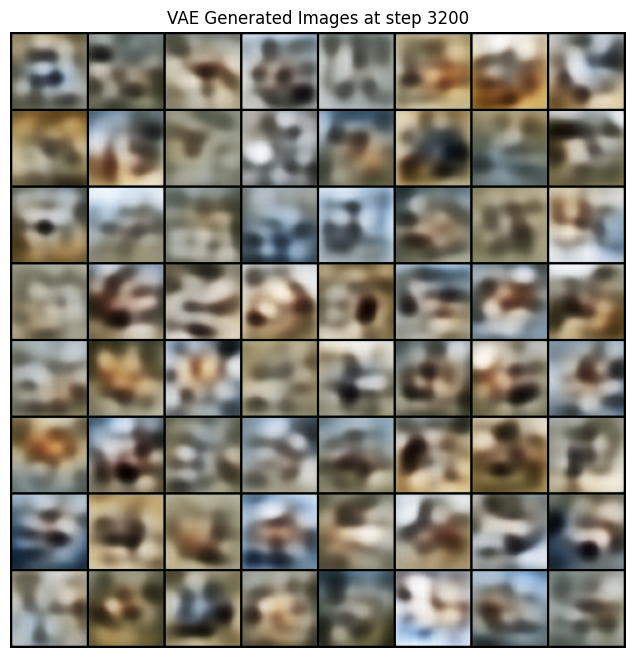

Epoch [9/10] Step [3300] Loss: 1.2557 | Recon: 1.0177 | KLD: 0.2380


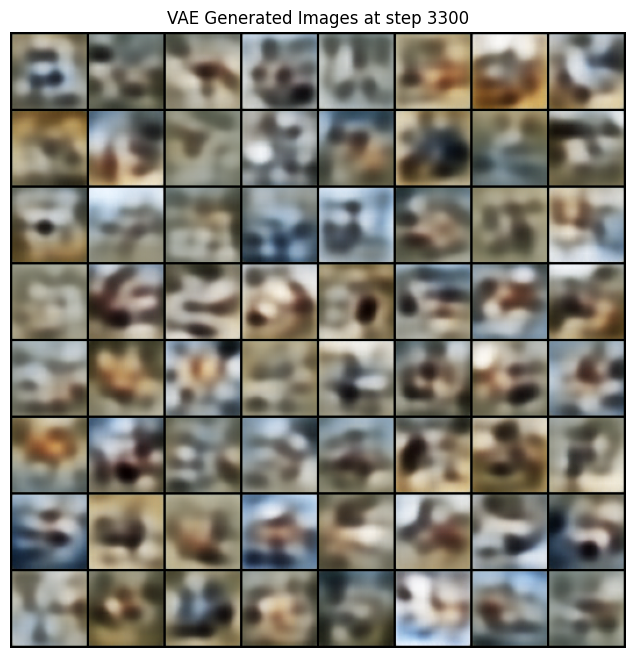

Epoch [9/10] Step [3400] Loss: 1.2159 | Recon: 0.9780 | KLD: 0.2379


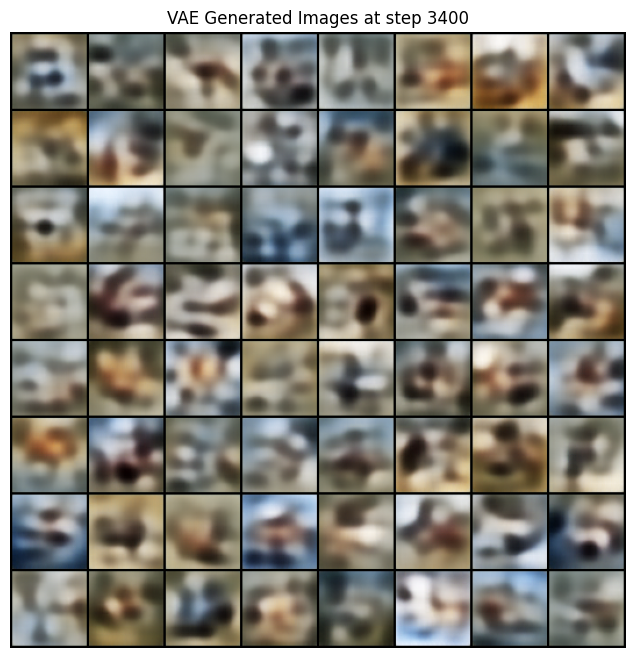

Epoch [9/10] Step [3500] Loss: 1.2799 | Recon: 1.0364 | KLD: 0.2435


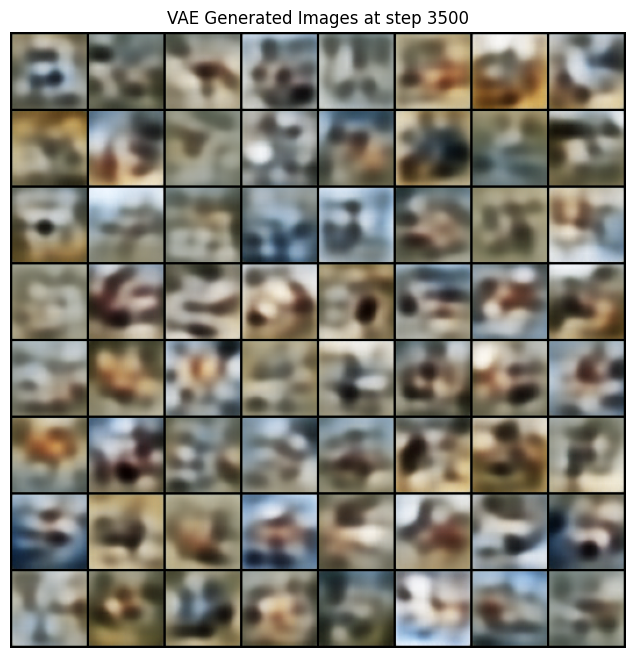

100%|██████████| 4/4 [00:02<00:00,  1.88it/s]



Epoch [9/10] Summary:
Train - Loss: 514.2713, Recon: 419.2725, KLD: 94.9988
Test  - Loss: 101.4052, Recon: 82.3061, KLD: 19.0991
FID   - 300.7550
Epoch [10/10] Step [3600] Loss: 1.2424 | Recon: 0.9987 | KLD: 0.2437


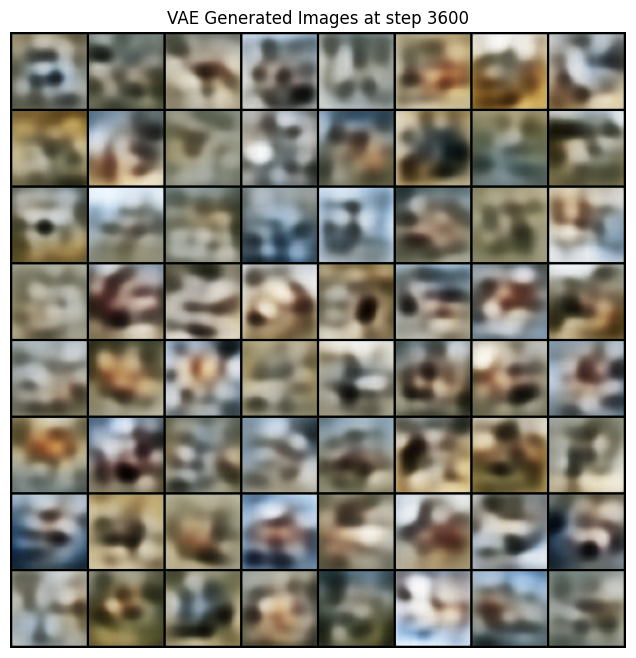

Epoch [10/10] Step [3700] Loss: 1.2351 | Recon: 0.9900 | KLD: 0.2451


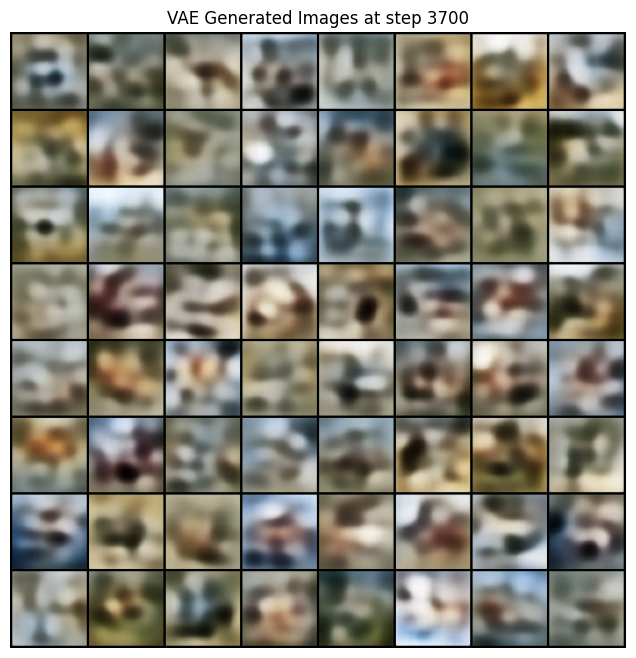

Epoch [10/10] Step [3800] Loss: 1.2422 | Recon: 0.9991 | KLD: 0.2431


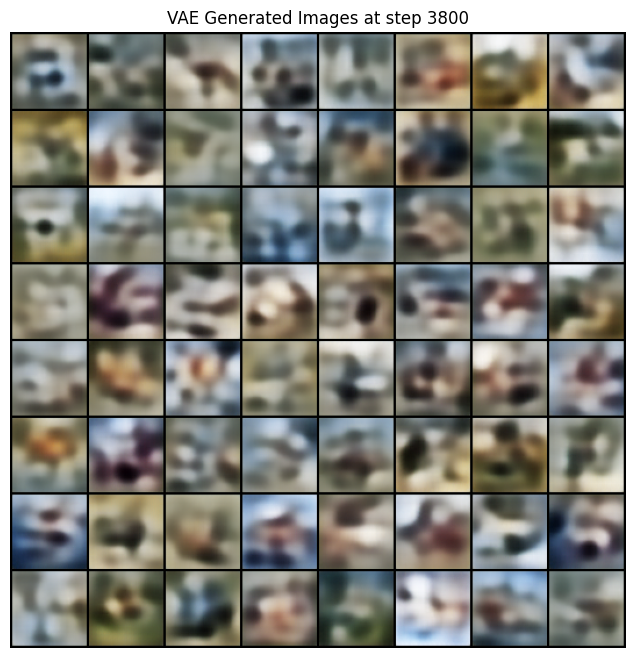

Epoch [10/10] Step [3900] Loss: 1.2161 | Recon: 0.9675 | KLD: 0.2486


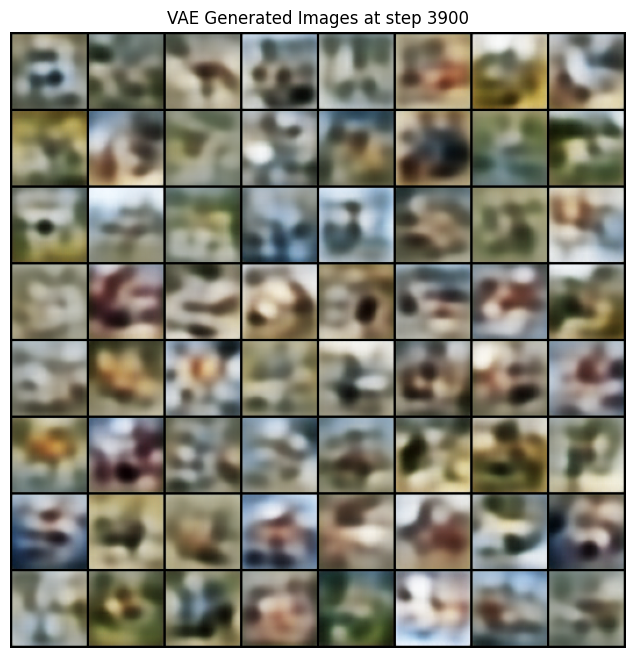

100%|██████████| 4/4 [00:02<00:00,  1.87it/s]



Epoch [10/10] Summary:
Train - Loss: 490.3404, Recon: 394.7137, KLD: 95.6267
Test  - Loss: 97.5089, Recon: 78.5070, KLD: 19.0019
FID   - 283.6995
VAE training completed!
Results saved to vae_training_metrics.json


In [ ]:
# for epoch in range(epochs):
#     # ------------------- TRAINING -------------------
#     vae.train()
#     epoch_train_loss, epoch_train_recon, epoch_train_kld = 0, 0, 0
#     train_batches = 0

#     for batch_idx, (images, _) in enumerate(train_data):
#         images = images.to(DEVICE)
#         optimizer_vae.zero_grad()

#         recon_images, mu, logvar = vae(images)
#         loss, recon_loss, kld_loss = vae_loss_function(recon_images, images, mu, logvar, beta)
#         loss.backward()
#         optimizer_vae.step()

#         epoch_train_loss += loss.item()
#         epoch_train_recon += recon_loss.item()
#         epoch_train_kld += kld_loss.item()
#         train_batches += 1

#         if step % 100 == 0:
#             print(
#                 f"Epoch [{epoch+1}/{epochs}] Step [{step}] "
#                 f"Loss: {(loss.item()/len(train_data.dataset)):.4f} | Recon: {(recon_loss.item()/len(train_data.dataset)):.4f} | KLD: {(kld_loss.item()/len(train_data.dataset)):.4f}"
#             )

#             with torch.no_grad():
#                 vae.eval()
#                 generated_samples = vae.decode(fixed_noise).detach().cpu()
#                 recon_samples, _, _ = vae(fixed_batch)
#                 recon_samples = recon_samples.detach().cpu()
#                 vae.train()

#             vutils.save_image(
#                 generated_samples,
#                 f"vae_samples/generated_step_{step}.png",
#                 normalize=True,
#                 nrow=8
#             )

#             vutils.save_image(
#                 recon_samples,
#                 f"vae_samples/reconstructed_step_{step}.png",
#                 normalize=True,
#                 nrow=8
#             )

#             grid = vutils.make_grid(generated_samples[:64], nrow=8, normalize=True)
#             npimg = grid.permute(1, 2, 0).numpy()
#             plt.figure(figsize=(8,8))
#             plt.imshow(npimg)
#             plt.title(f"VAE Generated Images at step {step}")
#             plt.axis("off")
#             plt.show()

#         if step % 1000 == 0:
#             checkpoint = {
#                 'model_state_dict': vae.state_dict(),
#                 'optimizer_state_dict': optimizer_vae.state_dict(),
#                 'step': step,
#                 'epoch': epoch,
#                 'results': results,
#                 'hyperparameters': results["hyperparameters"]
#             }
#             torch.save(checkpoint, f"vae_checkpoints/vae_step_{step}.pt")
#             print(f"VAE checkpoint saved at step {step}")

#         step += 1

#     # ------------------- TESTING -------------------
#     vae.eval()
#     epoch_test_loss, epoch_test_recon, epoch_test_kld = 0, 0, 0
#     test_batches = 0
#     with torch.no_grad():
#         for images, _ in test_data:
#             images = images.to(DEVICE)
#             recon_images, mu, logvar = vae(images)
#             loss, recon_loss, kld_loss = vae_loss_function(recon_images, images, mu, logvar, beta)
#             epoch_test_loss += loss.item()
#             epoch_test_recon += recon_loss.item()
#             epoch_test_kld += kld_loss.item()
#             test_batches += 1

#     # Record epoch averages
#     avg_train_loss = epoch_train_loss / len(train_data.dataset)
#     avg_train_recon = epoch_train_recon / len(train_data.dataset)
#     avg_train_kld = epoch_train_kld / len(train_data.dataset)
#     avg_test_loss = epoch_test_loss / len(train_data.dataset)
#     avg_test_recon = epoch_test_recon / len(train_data.dataset)
#     avg_test_kld = epoch_test_kld / len(train_data.dataset)

#     results["Train Loss"].append(avg_train_loss)
#     results["Train Reconstruction"].append(avg_train_recon)
#     results["Train KLD"].append(avg_train_kld)
#     results["Test Loss"].append(avg_test_loss)
#     results["Test Reconstruction"].append(avg_test_recon)
#     results["Test KLD"].append(avg_test_kld)
#     results["steps"].append(step)

#     for f in Path(real_dir_str).glob("*.png"):
#         f.unlink()
#     for f in Path(fake_dir_str).glob("*.png"):
#         f.unlink()

#     # Save a batch of real images (from test set)
#     num_real_saved = 0
#     for i, (images, _) in enumerate(test_data):
#         if num_real_saved >= 500:   # choose a limit you like (FID typically needs >=200)
#             break
#         for j, img in enumerate(images):
#             vutils.save_image(img, f"{real_dir_str}/real_{i}_{j}.png", normalize=True)
#             num_real_saved += 1

#     # Save a batch of generated fake images
#     with torch.no_grad():
#         vae.eval()
#         num_fake_saved = 0
#         while num_fake_saved < 500:    # generate at least as many as real
#             noise = torch.randn(batch_size, z_dim, device=DEVICE)
#             fake_images = vae.decode(noise).detach().cpu()
#             for j, img in enumerate(fake_images):
#                 vutils.save_image(img, f"{fake_dir_str}/fake_{num_fake_saved+j}.png", normalize=True)
#             num_fake_saved += fake_images.size(0)
#         vae.train()

#     # ------------------- FID CALCULATION -------------------
#     num_real = len(list(Path(real_dir_str).glob("*.png")))
#     num_fake = len(list(Path(fake_dir_str).glob("*.png")))
#     if num_real > 0 and num_fake > 0:
#         fid_value = fid_score.calculate_fid_given_paths(
#             [real_dir_str, fake_dir_str],
#             batch_size=128,
#             device=DEVICE,
#             dims=2048
#         )
#     else:
#         fid_value = None
#         print(f"[Warning] Skipping FID at epoch {epoch+1}: "
#               f"real={num_real} fake={num_fake} images found")

#     results["FID_score"].append(fid_value)

#     print(f"\nEpoch [{epoch+1}/{epochs}] Summary:")
#     print(f"Train - Loss: {avg_train_loss:.4f}, Recon: {avg_train_recon:.4f}, KLD: {avg_train_kld:.4f}")
#     print(f"Test  - Loss: {avg_test_loss:.4f}, Recon: {avg_test_recon:.4f}, KLD: {avg_test_kld:.4f}")
#     print(f"FID   - {fid_value:.4f}")

#     # Save metrics to JSON
#     with open("vae_training_metrics.json", 'w') as f:
#         json.dump(results, f, indent=2)

#     torch.cuda.empty_cache()

# print("VAE training completed!")
# print("Results saved to vae_training_metrics.json")


Generating final comparison samples...


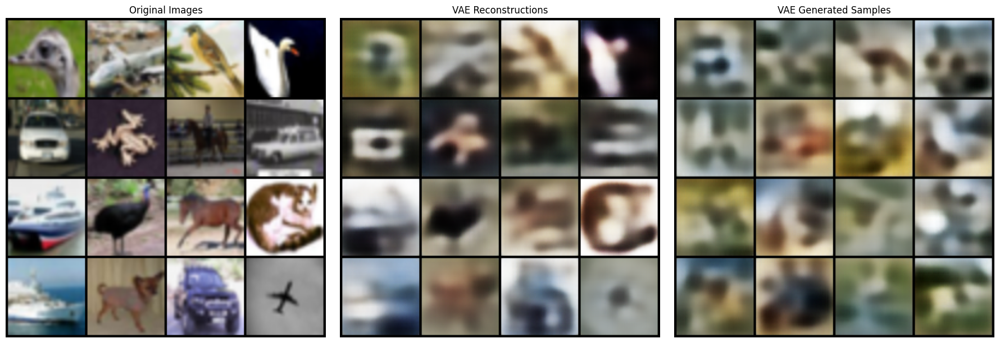

Final comparison saved to vae_final_comparison.png


In [ ]:
# # =============== FINAL COMPARISON SAMPLES ===============
# print("\nGenerating final comparison samples...")
# vae.eval()
# with torch.no_grad():
#     # Generate samples from random noise
#     final_generated = vae.decode(fixed_noise).detach().cpu()

#     # Get reconstructions of test images
#     final_reconstructions, _, _ = vae(fixed_batch)
#     final_reconstructions = final_reconstructions.detach().cpu()

#     # Create comparison plot
#     fig, axes = plt.subplots(1, 3, figsize=(18, 6))

#     # Original images
#     orig_grid = vutils.make_grid(fixed_batch.cpu()[:16], nrow=4, normalize=True)
#     axes[0].imshow(orig_grid.permute(1, 2, 0))
#     axes[0].set_title("Original Images")
#     axes[0].axis("off")

#     # Reconstructions
#     recon_grid = vutils.make_grid(final_reconstructions[:16], nrow=4, normalize=True)
#     axes[1].imshow(recon_grid.permute(1, 2, 0))
#     axes[1].set_title("VAE Reconstructions")
#     axes[1].axis("off")

#     # Generated samples
#     gen_grid = vutils.make_grid(final_generated[:16], nrow=4, normalize=True)
#     axes[2].imshow(gen_grid.permute(1, 2, 0))
#     axes[2].set_title("VAE Generated Samples")
#     axes[2].axis("off")

#     plt.tight_layout()
#     plt.savefig("vae_final_comparison.png", dpi=150, bbox_inches='tight')
#     plt.show()

# print("Final comparison saved to vae_final_comparison.png")

### Checkpoint: 
#### Sanity check
**Visual Quality:** As can be observed, VAE's reconstructions although do resemble to some degree the original image, it does so with a lot of visual blur. This happens as VAE's capture the image at a global level i.e shapes, color distributions, and semantic structure. This is a direct consequence of VAE's probabilistic learning style. A VAE maximizes a variational lower bound on the data log-likelihood, which can be written as $\newline$
$\mathcal{L}: = \mathbb{E}_{q_\phi (z|x)} [\log p_\theta (x|z)] - D_{KL} (q_\theta (z|x) || p(z)) \newline$

The first term drives accurate reconstruction, while the KL term forces the approximate posterior $q_\theta (z|x)$ to remain close to the Normally Distributed prior p(z). 
The p_\theta(x|z) is modelled with a guassian decoder, the loss we see in the image between pixels, is the mean squared errors between pixels. $\newline$

Moreover, the KL term constrains the information capacity of the latent. To satisfy the prior, the encoder injects stochastic noise and cannot transmit precise details about each image in the dataset. This intentional bottleneck increasingly discourages the decoder from memorizing exact pixel values and patterns, reinforcing smooth, low-variance reconstructions.

**FID(Frechet Inception Distance):** idea is to measure how close the distributions of generated image is to that of real images in a high level feature space, rather than comparing pixels directly.

How? $\newline$
**----------------------------------GPT GENERATED CONTENT-----------------------------------** 
$\newline$**1. Feature Extraction**  
Both the real dataset and the generated samples are passed through a pretrained **Inception-v3** network  
(commonly using the activations of the *pool3* layer).  
This produces high-level feature embeddings that capture semantic information  
(e.g., object shapes and textures) rather than raw pixel differences.

---

**2. Gaussian Approximation**  
The feature distributions of real and generated samples are modeled as multivariate Gaussians:

$
\mathcal{N}(\mu_r, \Sigma_r) \quad \text{and} \quad \mathcal{N}(\mu_g, \Sigma_g)
$

where  
$(\mu)$ is the mean vector and $(\Sigma)$ is the covariance matrix of the extracted features.

---

**3. Fréchet Distance**  
The distance between these two Gaussians is computed as:

$
\mathrm{FID} \;=\; \lVert \mu_r - \mu_g \rVert_2^2 \;+\;
\operatorname{Tr}\!\bigl(\Sigma_r + \Sigma_g - 2(\Sigma_r \Sigma_g)^{1/2}\bigr)
$

A **lower FID** indicates that the generated images are statistically closer  
to the real images in the feature space.

$\newline$
**----------------------------------GPT GENERATED CONTENT-----------------------------------** 
$\newline$

Why is it relevant? As VAE's optimize a variational lower bound on log likelihood and produces blurry images, pixel wise metrics(such as MSE) is unfair. FID captures high-level similarity between generated images and the data used, aligning better with human perception of "realism"$\newline$
If comparing VAE and GAN's a more better way to quantify their outputs is to calculate the FID score between the two.
VAE's generally have a higher FID compared to GAN's due to blurrier outputs even though they capture more diverse data. 

In [ ]:
# plt.figure(figsize=(15, 5))

# plt.subplot(1, 4, 1)
# plt.plot(results["Train Loss"], label="Train Loss")
# plt.plot(results["Test Loss"], label="Test Loss")
# plt.xlabel("Epoch")
# plt.ylabel("Loss")
# plt.title("Training Progress")
# plt.legend()

# plt.subplot(1, 4, 2)
# plt.plot(results["Train Reconstruction"], label="Train Recon")
# plt.plot(results["Test Reconstruction"], label="Test Recon")
# plt.xlabel("Epoch")
# plt.ylabel("Loss Components")
# plt.title("Loss Components")
# plt.legend()

# plt.subplot(1, 4, 3)
# plt.plot(results["FID"])
# plt.xlabel("Epoch")
# plt.ylabel("FID Score")
# plt.title("FID Score (Lower is Better)")

# plt.subplot(1, 4, 4)
# plt.plot(results["Train KLD"], label="Train KLD")
# plt.plot(results["Test KLD"], label="Test KLD")
# plt.xlabel("epoch")
# plt.ylabel("KL_Div")
# plt.tight_layout()
# plt.savefig("outputs/training_curves.png", dpi=150, bbox_inches='tight')
# plt.show()

# # Save results dictionary
# torch.save(results, "outputs/training_results.pt")
# print("Training completed! All results saved.")

In [ ]:
# torch.save(original_grid, f"outputs/original_epoch_{epoch+1}.pt")
# torch.save(recon_grid, f"outputs/reconstructions_epoch_{epoch+1}.pt")
# torch.save(generated_grid, f"outputs/generated_epoch_{epoch+1}.pt")
# output_path = f"outputs/vae_outputs_epoch_{epoch+1}.png"
# plt.savefig(output_path, dpi=150, bbox_inches='tight')
# plt.show()
# print(f"Outputs saved to {output_path}")
# checkpoint = {
#     'epoch': epoch + 1,
#     'model_state_dict': vae.state_dict(),
#     'optimizer_state_dict': optimizer_vae.state_dict(),
#     'train_loss': results["Train Loss"][-1],
#     'test_loss': results["Test Loss"][-1],
#     'fid': fid_value,
#     'results': results
# }
# checkpoint_path = f"checkpoints/vae_epoch_{epoch+1}.pth"
# torch.save(checkpoint, checkpoint_path)
# print(f"Model saved to {checkpoint_path}")

<Figure size 640x480 with 0 Axes>

Outputs saved to outputs/vae_outputs_epoch_10.png
Model saved to checkpoints/vae_epoch_10.pth


In [ ]:
# with open("vae_training_metrics.json", 'w') as f:
#       json.dump(results, f, indent=2)

In [ ]:
# checkpoint = {
#     'model_state_dict': vae.state_dict(),
#     'optimizer_state_dict': optimizer_vae.state_dict(),
#     'step': step,
#     'epoch': epoch,
#     'results': results,
#     'hyperparameters': results["hyperparameters"]
# }
# torch.save(checkpoint, f"vae_checkpoints/vae_step_{step}.pt")
# print(f"VAE checkpoint saved at step {step}")

VAE checkpoint saved at step 3910


### Loading from checkpoint

In [ ]:
with open("./vae_training_metrics.json", "r") as f:
    metrics = json.load(f)

checkpoint_loader = torch.load("vae_checkpoints/vae_step_3910.pt", map_location=DEVICE,weights_only=False)
checkpoint_vae = VAE().to(DEVICE)
checkpoint_vae.load_state_dict(checkpoint_loader['model_state_dict'])


VAE(
  (enc_conv1): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (enc_bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (enc_conv2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (enc_bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (enc_conv3): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (enc_bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (enc_conv4): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (enc_bn4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (enc_fc): Linear(in_features=8192, out_features=512, bias=True)
  (fc_mu): Linear(in_features=512, out_features=64, bias=True)
  (fc_logvar): Linear(in_features=512, out_features=64, bias=True)
  (dec_fc): Linear(in_features=64, out_features=512, bias=True)
  (dec_fc2): Linear(in_features=

### Plotting Results and making Tables


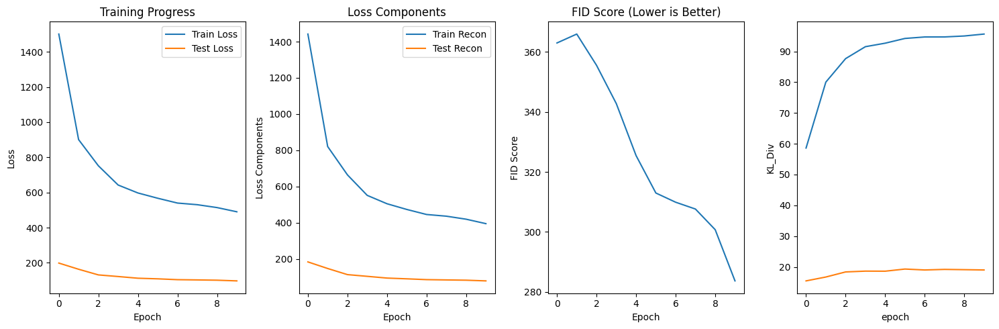

Training completed! All results saved.


In [12]:
os.makedirs("outputs", exist_ok=True)
plt.figure(figsize=(15, 5))

plt.subplot(1, 4, 1)
plt.plot(metrics["Train Loss"], label="Train Loss")
plt.plot(metrics["Test Loss"], label="Test Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Training Progress")
plt.legend()

plt.subplot(1, 4, 2)
plt.plot(metrics["Train Reconstruction"], label="Train Recon")
plt.plot(metrics["Test Reconstruction"], label="Test Recon")
plt.xlabel("Epoch")
plt.ylabel("Loss Components")
plt.title("Loss Components")
plt.legend()

plt.subplot(1, 4, 3)
plt.plot(metrics["FID_score"])
plt.xlabel("Epoch")
plt.ylabel("FID Score")
plt.title("FID Score (Lower is Better)")

plt.subplot(1, 4, 4)
plt.plot(metrics["Train KLD"], label="Train KLD")
plt.plot(metrics["Test KLD"], label="Test KLD")
plt.xlabel("epoch")
plt.ylabel("KL_Div")
plt.tight_layout()
plt.savefig("outputs/training_curves.png", dpi=150, bbox_inches='tight')
plt.show()

# Save results dictionary
torch.save(metrics, "outputs/training_results.pt")
print("Training completed! All results saved.")

In [23]:
import pandas as pd
from IPython.display import display

flat_metrics = {k: v for k, v in metrics.items() if isinstance(v, list)}
df = pd.DataFrame(flat_metrics)
# df.drop("steps")
df.index = range(1, len(df)+1)
df.index.name = "Epoch"
df = df.drop('steps',axis=1)
display(df)
# print(df.to_string(index=True))
df.to_csv("vae_metrics_table.csv", index=True) 


,Train Loss,Train Reconstruction,Train KLD,Test Loss,Test Reconstruction,Test KLD,FID_score
Epoch,,,,,,,
1,1500.736754,1442.135180,58.601580,198.820126,183.364862,15.455263,362.959865
2,900.673396,820.659345,80.014050,163.671225,146.959927,16.711299,365.928266
3,751.820090,664.170904,87.649186,131.511565,113.148382,18.363183,355.516593
4,642.421317,550.898398,91.522918,122.294485,103.667414,18.627071,342.750170
5,597.344863,504.685631,92.659232,112.658930,94.055507,18.603423,325.431544
6,567.351355,473.152422,94.198933,109.216041,89.912893,19.303148,312.974112
7,539.960232,445.279586,94.680648,104.415889,85.416572,18.999316,309.905635
8,530.646996,435.957101,94.689893,103.004071,83.818181,19.185890,307.637587
9,514.271266,419.272452,94.998814,101.405190,82.306138,19.099052,300.755003


Index(['Train Loss', 'Train Reconstruction', 'Train KLD', 'Test Loss',
       'Test Reconstruction', 'Test KLD', 'steps', 'FID_score'],
      dtype='object')


### Diversity Check